In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
import plotly.express as px
from tqdm.notebook import tqdm

In [ ]:
!pip install -U ydata-profiling[notebook]==4.0.0 matplotlib==3.5.1
from ydata_profiling import ProfileReport

# 1. Airports, Airlines, and Routes

Airports, Airlines, and Routes is a comprehensive dataset which includes air travel data including airports, airlines, routes, and airplanes. The database contains over 10,000 data points compiled by OpenFlights (https://openflights.org) collected from a variety of sources.

Additional information is available here - https://openflights.org

Also, while you're there, support them through a donation as this data is super labor intensive to collect.

Note from them:
Creating and maintaining this database has required and continues to require an immense amount of work, which is why it would cost you over one thousand dollars to buy it from a commercial supplier. We need your support to keep this database up-to-date: just click on the PayPal link to the right (Visa, MasterCard, American Express and Discover also accepted).

In [ ]:
df_airlines = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/data/airlines.csv')
df_airplanes = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/data/airplanes.csv')
df_airports = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/data/airports.csv')
df_routes = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/data/routes.csv')

##Airlanes

In [ ]:
df_airlines.head()

,Airline ID,Name,Alias,IATA,ICAO,Callsign,Country,Active
0,-1,Unknown,\N,-,NaN,\N,\N,Y
1,1,Private flight,\N,-,NaN,NaN,NaN,Y
2,2,135 Airways,\N,NaN,GNL,GENERAL,United States,N
3,3,1Time Airline,\N,1T,RNX,NEXTIME,South Africa,Y
4,4,2 Sqn No 1 Elementary Flying Training School,\N,NaN,WYT,NaN,United Kingdom,N


In [ ]:
df_airlines_active = df_airlines[df_airlines["Active"]=="Y"]
df_airlines_inactive = df_airlines[df_airlines["Active"]=="N"]

print(f"Number of active airlines: {len(df_airlines_active)}")
print(f"Number of inactive airlines: {len(df_airlines_inactive)}")

Number of active airlines: 1255
Number of inactive airlines: 4906


In [ ]:
df_airlines_counts = df_airlines.groupby('Country')['Airline ID'].count().sort_values(ascending=False).head(20)
df_airlines_counts

Country
United States     1099
Mexico             440
United Kingdom     414
Canada             323
Russia             238
Spain              168
Germany            135
France             123
Australia           94
Italy               93
South Africa        91
Ukraine             90
Nigeria             85
Kazakhstan          79
China               72
Sweden              70
Switzerland         60
Brazil              60
Netherlands         52
Thailand            52
Name: Airline ID, dtype: int64

##Airplanes

In [ ]:
df_airplanes.head()

,Name,IATA code,ICAO code
0,Aerospatiale (Nord) 262,ND2,N262
1,Aerospatiale (Sud Aviation) Se.210 Caravelle,CRV,S210
2,Aerospatiale SN.601 Corvette,NDC,S601
3,Aerospatiale/Alenia ATR 42-300,AT4,AT43
4,Aerospatiale/Alenia ATR 42-500,AT5,AT45


In [ ]:
print(f"Number of airplanes: {len(df_airplanes)}")

Number of airplanes: 246


##Airports

In [ ]:
df_airports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7698 entries, 0 to 7697
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Airport ID             7698 non-null   int64  
 1   Name                   7698 non-null   object 
 2   City                   7649 non-null   object 
 3   Country                7698 non-null   object 
 4   IATA                   7698 non-null   object 
 5   ICAO                   7698 non-null   object 
 6   Latitude               7698 non-null   float64
 7   Longitude              7698 non-null   float64
 8   Altitude               7698 non-null   int64  
 9   Timezone               7698 non-null   object 
 10  DST                    7698 non-null   object 
 11  Tz database time zone  7698 non-null   object 
 12  Type                   7698 non-null   object 
 13  Source                 7698 non-null   object 
dtypes: float64(2), int64(2), object(10)
memory usage: 842.1+

In [ ]:
df_airports.head()

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source
0,1,Goroka Airport,Goroka,Papua New Guinea,GKA,AYGA,-6.081690,145.391998,5282,10,U,Pacific/Port_Moresby,airport,OurAirports
1,2,Madang Airport,Madang,Papua New Guinea,MAG,AYMD,-5.207080,145.789001,20,10,U,Pacific/Port_Moresby,airport,OurAirports
2,3,Mount Hagen Kagamuga Airport,Mount Hagen,Papua New Guinea,HGU,AYMH,-5.826790,144.296005,5388,10,U,Pacific/Port_Moresby,airport,OurAirports
3,4,Nadzab Airport,Nadzab,Papua New Guinea,LAE,AYNZ,-6.569803,146.725977,239,10,U,Pacific/Port_Moresby,airport,OurAirports
4,5,Port Moresby Jacksons International Airport,Port Moresby,Papua New Guinea,POM,AYPY,-9.443380,147.220001,146,10,U,Pacific/Port_Moresby,airport,OurAirports


In [ ]:
df_airports['IATA'] = df_airports['IATA'].astype(str)

In [ ]:
print(df_airports["Type"].unique())
print(df_airports["DST"].unique())

['airport']
['U' 'E' 'N' 'A' 'S' 'Z' 'O' '\\N']


In [ ]:
print(f'Number of airports: {len(df_airports[df_airports["Type"]=="airport"])}')

Number of airports: 7698


In [ ]:
df_airports_country_counts = df_airports.groupby('Country')['Airport ID'].count().sort_values(ascending=False).head(20)
print(df_airports_country_counts)

Country
United States     1512
Canada             430
Australia          334
Russia             264
Brazil             264
Germany            249
China              241
France             217
United Kingdom     167
India              148
Indonesia          145
Japan              123
South Africa        99
Argentina           96
Mexico              84
Italy               83
Iran                82
Sweden              77
Turkey              76
Colombia            75
Name: Airport ID, dtype: int64


In [ ]:
df_airports_city_counts = df_airports.groupby('City')['Airport ID'].count().sort_values(ascending=False).head(20)
df_airports_city_counts

City
London          9
Columbus        8
San Jose        7
Georgetown      7
Alexandria      6
Jacksonville    6
Santiago        6
New York        6
Greenville      6
Houston         6
Moscow          6
Burlington      5
Victoria        5
Hamilton        5
Glasgow         5
Richmond        5
Vancouver       5
San Antonio     5
Rome            5
Izmir           5
Name: Airport ID, dtype: int64

In [ ]:
df_airports_altiduide = df_airports.sort_values(by="Altitude", ascending=False)
df_airports_altiduide.head(10)

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source
6542,9310,Daocheng Yading Airport,Daocheng,China,0 GKA\n1 MAG\n2 HGU\n3 ...,ZUDC,29.323056,100.053333,14472,8,N,Asia/Shanghai,airport,OurAirports
5028,6396,Qamdo Bangda Airport,Bangda,China,0 GKA\n1 MAG\n2 HGU\n3 ...,ZUBD,30.553600,97.108299,14219,8,U,Asia/Shanghai,airport,OurAirports
6393,8921,Kangding Airport,Kangding,China,0 GKA\n1 MAG\n2 HGU\n3 ...,ZUKD,30.157500,101.734722,14042,8,N,Asia/Shanghai,airport,OurAirports
5872,7932,Ngari Gunsa Airport,Shiquanhe,China,0 GKA\n1 MAG\n2 HGU\n3 ...,ZUAL,32.100000,80.053056,14022,8,N,Asia/Shanghai,airport,OurAirports
2625,2762,El Alto International Airport,La Paz,Bolivia,0 GKA\n1 MAG\n2 HGU\n3 ...,SLLP,-16.513300,-68.192299,13355,-4,U,America/La_Paz,airport,OurAirports
2627,2764,Capitan Nicolas Rojas Airport,Potosi,Bolivia,0 GKA\n1 MAG\n2 HGU\n3 ...,SLPO,-19.543100,-65.723701,12913,-4,U,America/La_Paz,airport,OurAirports
5851,7894,Yushu Batang Airport,Yushu,China,0 GKA\n1 MAG\n2 HGU\n3 ...,ZYLS,32.836389,97.036389,12816,8,U,Asia/Shanghai,airport,OurAirports
6420,8969,Copacabana Airport,Copacabana,Bolivia,0 GKA\n1 MAG\n2 HGU\n3 ...,SLCC,-16.191099,-69.095596,12591,-4,U,America/La_Paz,airport,OurAirports
2654,2792,Inca Manco Capac International Airport,Juliaca,Peru,0 GKA\n1 MAG\n2 HGU\n3 ...,SPJL,-15.467100,-70.158203,12552,-5,U,America/Lima,airport,OurAirports
7538,13483,Golog Maqin Airport,Golog,China,0 GKA\n1 MAG\n2 HGU\n3 ...,ZLGL,34.418066,100.301144,12426,8,N,\N,airport,OurAirports


In [ ]:
df_airports_altiduide.tail(10)

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source
3558,3758,El Centro NAF Airport (Vraciu Field),El Centro,United States,0 GKA\n1 MAG\n2 HGU\n3 ...,KNJK,32.829201,-115.671996,-42,-8,A,America/Los_Angeles,airport,OurAirports
3489,3689,Imperial County Airport,Imperial,United States,0 GKA\n1 MAG\n2 HGU\n3 ...,KIPL,32.834202,-115.579002,-54,-8,A,America/Los_Angeles,airport,OurAirports
4598,5932,Noshahr Airport,Noshahr,Iran,0 GKA\n1 MAG\n2 HGU\n3 ...,OINN,36.663300,51.464699,-61,3.5,E,Asia/Tehran,airport,OurAirports
2811,2966,Astrakhan Airport,Astrakhan,Russia,0 GKA\n1 MAG\n2 HGU\n3 ...,URWA,46.283298,48.006302,-65,4,N,Europe/Samara,airport,OurAirports
7691,14104,Privolzhskiy Air Base,Astrakhan,Russia,0 GKA\n1 MAG\n2 HGU\n3 ...,XRAP,46.396000,47.893000,-66,\N,\N,\N,airport,OurAirports
2069,2151,Ramsar Airport,Ramsar,Iran,0 GKA\n1 MAG\n2 HGU\n3 ...,OINR,36.909901,50.679600,-70,3.5,E,Asia/Tehran,airport,OurAirports
4087,4357,Atyrau Airport,Atyrau,Kazakhstan,0 GKA\n1 MAG\n2 HGU\n3 ...,UATG,47.121899,51.821400,-72,5,U,Asia/Oral,airport,OurAirports
5721,7646,Jacqueline Cochran Regional Airport,Palm Springs,United States,0 GKA\n1 MAG\n2 HGU\n3 ...,KTRM,33.626701,-116.160004,-115,-8,A,America/Los_Angeles,airport,OurAirports
1553,1595,Ein Yahav Airfield,Eyn-yahav,Israel,0 GKA\n1 MAG\n2 HGU\n3 ...,LLEY,30.621700,35.203300,-164,2,E,Asia/Jerusalem,airport,OurAirports
1558,1600,Bar Yehuda Airfield,Metzada,Israel,0 GKA\n1 MAG\n2 HGU\n3 ...,LLMZ,31.328199,35.388599,-1266,2,E,Asia/Jerusalem,airport,OurAirports


##Routes

In [ ]:
df_routes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67663 entries, 0 to 67662
Data columns (total 9 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Airline                 67663 non-null  object
 1   Airline ID              67663 non-null  object
 2   Source airport          67663 non-null  object
 3   Source airport ID       67663 non-null  object
 4   Destination airport     67663 non-null  object
 5   Destination airport ID  67663 non-null  object
 6   Codeshare               14597 non-null  object
 7   Stops                   67663 non-null  int64 
 8   Equipment               67645 non-null  object
dtypes: int64(1), object(8)
memory usage: 4.6+ MB


In [ ]:
df_routes.head()

,Airline,Airline ID,Source airport,Source airport ID,Destination airport,Destination airport ID,Codeshare,Stops,Equipment
0,2B,410,AER,2965,KZN,2990,NaN,0,CR2
1,2B,410,ASF,2966,KZN,2990,NaN,0,CR2
2,2B,410,ASF,2966,MRV,2962,NaN,0,CR2
3,2B,410,CEK,2968,KZN,2990,NaN,0,CR2
4,2B,410,CEK,2968,OVB,4078,NaN,0,CR2


In [ ]:
df_routes_N = df_routes[df_routes['Source airport ID'] != '\\N']
df_routes_N = df_routes_N[df_routes_N['Destination airport ID'] != '\\N']

df_routes_N

,Airline,Airline ID,Source airport,Source airport ID,Destination airport,Destination airport ID,Codeshare,Stops,Equipment
0,2B,410,AER,2965,KZN,2990,NaN,0,CR2
1,2B,410,ASF,2966,KZN,2990,NaN,0,CR2
2,2B,410,ASF,2966,MRV,2962,NaN,0,CR2
3,2B,410,CEK,2968,KZN,2990,NaN,0,CR2
4,2B,410,CEK,2968,OVB,4078,NaN,0,CR2
...,...,...,...,...,...,...,...,...,...
67658,ZL,4178,WYA,6334,ADL,3341,NaN,0,SF3
67659,ZM,19016,DME,4029,FRU,2912,NaN,0,734
67660,ZM,19016,FRU,2912,DME,4029,NaN,0,734
67661,ZM,19016,FRU,2912,OSS,2913,NaN,0,734


In [ ]:
df_routes_N['Source airport ID'] = df_routes_N['Source airport ID'].astype(int)
df_routes_N['Destination airport ID'] = df_routes_N['Destination airport ID'].astype(int)

In [ ]:
print(f"Ilość źródłowych lotnisk: {df_routes['Source airport'].nunique()}")
print(f"Ilość docelowych lotnisk: {df_routes['Destination airport'].nunique()}")

Ilość źródłowych lotnisk: 3409
Ilość docelowych lotnisk: 3418


In [ ]:
AIRPORT_ID = 2965

source_count = len(df_routes_N[df_routes_N['Source airport ID'] == AIRPORT_ID])

# Policzenie wystąpień jako docelowego
destination_count = len(df_routes_N[df_routes_N['Destination airport ID'] == AIRPORT_ID])

# Suma wystąpień jako źródłowego i docelowego
total_count = source_count + destination_count
total_count

52

In [ ]:
df_routes_N['Stops'].value_counts()

0    67229
1       11
Name: Stops, dtype: int64

In [ ]:
print(df_routes_N.groupby("Airline ID")["Airline ID"].count().sort_values(ascending=False).head(10))
df_airlines[df_airlines["Airline ID"] == 4296]

Airline ID
4296    2484
24      2352
5209    2180
2009    1981
5265    1960
1767    1452
1758    1263
751     1260
4547    1146
2297    1130
Name: Airline ID, dtype: int64


,Airline ID,Name,Alias,IATA,ICAO,Callsign,Country,Active
4290,4296,Ryanair,\N,FR,RYR,RYANAIR,Ireland,Y


##Graph

<Axes: xlabel='Longitude', ylabel='Latitude'>

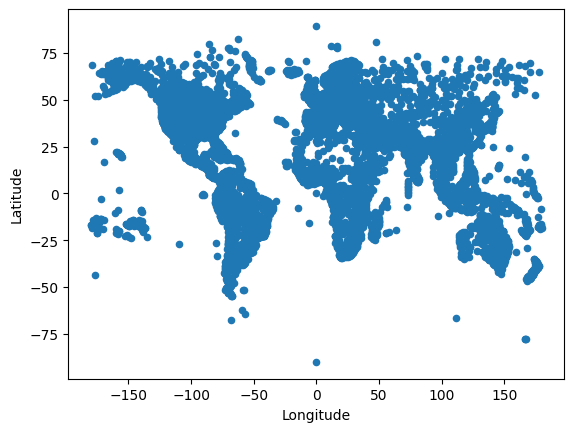

In [ ]:
df_airports.plot(x="Longitude", y="Latitude", kind="scatter")

In [ ]:
countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
countries.head()

<ipython-input-59-2254b7851a4c>:1: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


<Axes: >

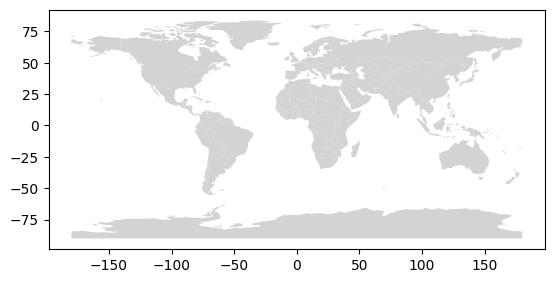

In [ ]:
countries.plot(color="lightgrey")

<ipython-input-61-e3ac0c0d2fc1>:4: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


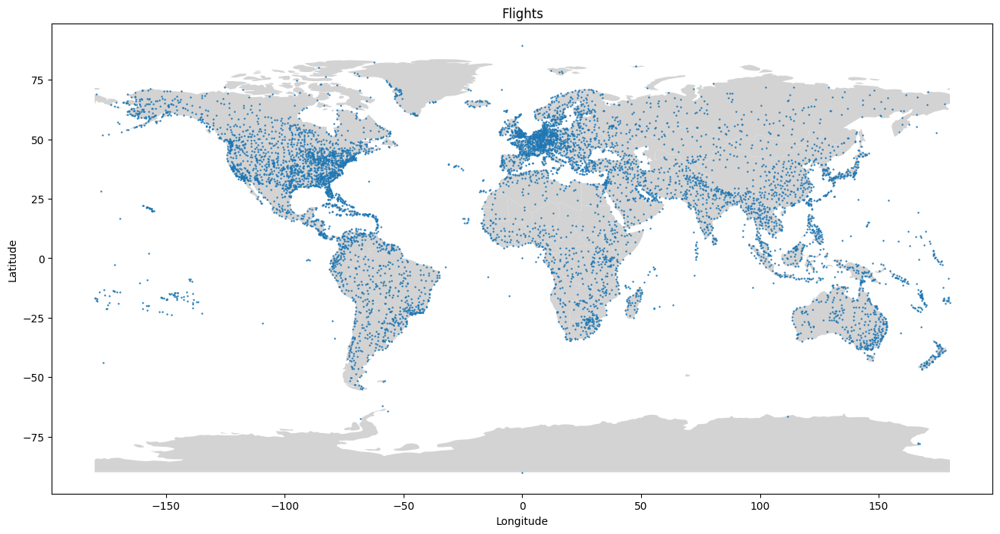

In [ ]:
# initialize an axis
fig, ax = plt.subplots(figsize=(16,14))
# plot map on axis
countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

countries.plot(color="lightgrey", ax=ax)

# plot points
df_airports.plot(x="Longitude", y="Latitude", kind="scatter", s=0.5,
        title=f"Flights", ax=ax)

plt.show();

In [ ]:
G = nx.DiGraph()

for _, route in tqdm(df_routes_N.iterrows()):
    source_airport = df_airports[df_airports["Airport ID"] == route["Source airport ID"]]["IATA"]
    dest_airport = df_airports[df_airports["Airport ID"] == route["Destination airport ID"]]["IATA"]

    if len(source_airport) and len(dest_airport):
        # Dodawanie krawędzi z atrybutem 'connection_count'
        if G.has_edge(source_airport.iloc[0], dest_airport.iloc[0]):
            G.edges[source_airport.iloc[0], dest_airport.iloc[0]]['connection_count'] += 1
        else:
            G.add_edge(source_airport.iloc[0], dest_airport.iloc[0], connection_count=1)


0it [00:00, ?it/s]

In [ ]:
#ilość węzłów, ilość krawędzi, histogram stopnia węzłów.
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()
print(f'Nodes: {num_nodes}\nEdges: {num_edges}')

Nodes: 3196
Edges: 36893


In [ ]:
total_connection_count = sum(data['connection_count'] for _, _, data in G.edges(data=True) if 'connection_count' in data)
print(f"Connection count in graph: {total_connection_count}")

Connection count in graph: 66771


In [ ]:
node_total_connection_counts = {}

for node in G.nodes():
    total_connection_count = sum(data['connection_count'] for _, _, data in G.edges(node, data=True) if 'connection_count' in data)
    node_total_connection_counts[node] = total_connection_count

G_df_connection = pd.DataFrame(list(node_total_connection_counts.items()), columns=['AirPort', 'connection_count'])

In [ ]:
nodes_degree = list(G.degree(G.nodes))
G_df = pd.DataFrame(nodes_degree,columns=['AirPort', 'node_degree'])

In [ ]:
G_df['node_degree'].nunique()

221

In [ ]:
fig = px.histogram(G_df, x='node_degree',
                   width=800, height=500,
                   title='Degrees histogram', nbins=142)
fig.show()

In [ ]:
# najwięcej lotów z udziałem lotniska

sorted_airports = G_df_connection.sort_values(by='connection_count', ascending=False)
sorted_airports_list = list(sorted_airports['AirPort'])
print(sorted_airports_list[:25])
df_airports[df_airports['IATA'] == "ATL"]

['ATL', 'ORD', 'PEK', 'LHR', 'CDG', 'FRA', 'LAX', 'DFW', 'JFK', 'AMS', 'PVG', 'SIN', 'BCN', 'ICN', 'MIA', 'MUC', 'DEN', 'LGW', 'HKG', 'ISL', 'DXB', 'CAN', 'FCO', 'MAD', 'BKK']


,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source
3482,3682,Hartsfield Jackson Atlanta International Airport,Atlanta,United States,ATL,KATL,33.6367,-84.428101,1026,-5,A,America/New_York,airport,OurAirports


In [ ]:
sorted_airports[["AirPort", "connection_count"]].head(10)

,AirPort,connection_count
189,ATL,915
116,ORD,558
276,PEK,531
448,LHR,525
430,CDG,524
483,FRA,497
329,LAX,489
356,DFW,469
358,JFK,456
214,AMS,453


In [ ]:
# najpopularniejsze trasy
sorted_airports = sorted(G.edges(data=True), key=lambda x: x[2].get('connection_count', 0), reverse=True)
sorted_airports[:10]

[('ORD', 'ATL', {'connection_count': 20}),
 ('ATL', 'ORD', {'connection_count': 19}),
 ('ORD', 'MSY', {'connection_count': 13}),
 ('HKT', 'BKK', {'connection_count': 13}),
 ('BKK', 'HKG', {'connection_count': 12}),
 ('HKG', 'BKK', {'connection_count': 12}),
 ('ATL', 'MIA', {'connection_count': 12}),
 ('CAN', 'HGH', {'connection_count': 12}),
 ('JFK', 'LHR', {'connection_count': 12}),
 ('MIA', 'ATL', {'connection_count': 12})]

In [ ]:
# z ilu róznych miejsc na dane lotnisko
sorted_airports = G_df.sort_values(by='node_degree', ascending=False)
sorted_airports_list = list(sorted_airports['AirPort'])
sorted_airports_list[:25]

['FRA',
 'CDG',
 'AMS',
 'ISL',
 'ATL',
 'ORD',
 'PEK',
 'MUC',
 'DME',
 'DFW',
 'DXB',
 'LHR',
 'IAH',
 'DEN',
 'LGW',
 'BCN',
 'JFK',
 'FCO',
 'MAD',
 'EWR',
 'STN',
 'PVG',
 'LAX',
 'DUS',
 'BRU']

In [ ]:
sorted_airports[["AirPort", "node_degree"]].head(10)

,AirPort,node_degree
483,FRA,477
430,CDG,470
214,AMS,463
751,ISL,449
189,ATL,433
116,ORD,409
276,PEK,406
180,MUC,380
6,DME,375
356,DFW,372


In [ ]:
top_airports_names = df_airports[df_airports['IATA'].isin(sorted_airports_list[:50])]

In [ ]:
top_airports_names

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source
191,193,Lester B. Pearson International Airport,Toronto,Canada,YYZ,CYYZ,43.677200,-79.630600,569,-5,A,America/Toronto,airport,OurAirports
299,302,Brussels Airport,Brussels,Belgium,BRU,EBBR,50.901402,4.484440,184,1,E,Europe/Brussels,airport,OurAirports
336,340,Frankfurt am Main Airport,Frankfurt,Germany,FRA,EDDF,50.033333,8.570556,364,1,E,Europe/Berlin,airport,OurAirports
341,345,Düsseldorf Airport,Duesseldorf,Germany,DUS,EDDL,51.289501,6.766780,147,1,E,Europe/Berlin,airport,OurAirports
342,346,Munich Airport,Munich,Germany,MUC,EDDM,48.353802,11.786100,1487,1,E,Europe/Berlin,airport,OurAirports
473,478,Manchester Airport,Manchester,United Kingdom,MAN,EGCC,53.353699,-2.274950,257,0,E,Europe/London,airport,OurAirports
497,502,London Gatwick Airport,London,United Kingdom,LGW,EGKK,51.148102,-0.190278,202,0,E,Europe/London,airport,OurAirports
502,507,London Heathrow Airport,London,United Kingdom,LHR,EGLL,51.470600,-0.461941,83,0,E,Europe/London,airport,OurAirports
542,548,London Stansted Airport,London,United Kingdom,STN,EGSS,51.884998,0.235000,348,0,E,Europe/London,airport,OurAirports
574,580,Amsterdam Airport Schiphol,Amsterdam,Netherlands,AMS,EHAM,52.308601,4.763890,-11,1,E,Europe/Amsterdam,airport,OurAirports


<ipython-input-103-93e7dadb15a5>:3: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.



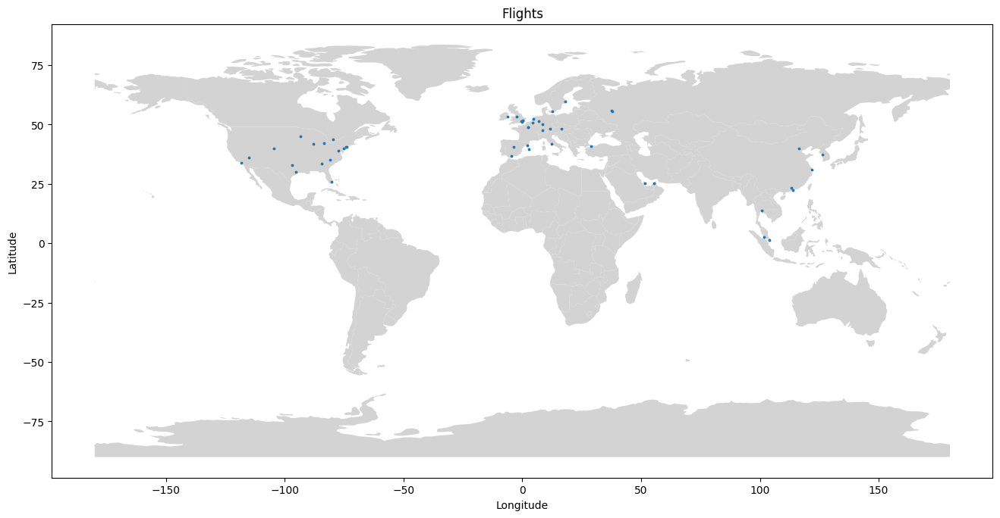

In [ ]:
fig, ax = plt.subplots(figsize=(16,14))
# plot map on axis
countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

countries.plot(color="lightgrey", ax=ax)

# plot points
top_airports_names.plot(x="Longitude", y="Latitude", kind="scatter", s=3,
        title=f"Flights", ax=ax)

plt.show();

#2. EURECOM AML Air travel delay forecasting

In [ ]:
df_airlines_d = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/eurocom_data/airlines.csv')
df_airports_d = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/eurocom_data/airports.csv')

train_features = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/eurocom_data/train_features.csv')
train_targets = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/eurocom_data/train_targets.csv')

test_features = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/eurocom_data/test_features.csv')
baseline = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/eurocom_data/submission_baseline.csv')

##airlines

In [ ]:
df_airlines_d.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14 entries, 0 to 13
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   IATA_CODE  14 non-null     object
 1   AIRLINE    14 non-null     object
dtypes: object(2)
memory usage: 352.0+ bytes


In [ ]:
df_airlines_d

,IATA_CODE,AIRLINE
0,UA,United Air Lines Inc.
1,AA,American Airlines Inc.
2,US,US Airways Inc.
3,F9,Frontier Airlines Inc.
4,B6,JetBlue Airways
5,OO,Skywest Airlines Inc.
6,AS,Alaska Airlines Inc.
7,NK,Spirit Air Lines
8,WN,Southwest Airlines Co.
9,DL,Delta Air Lines Inc.


##airports

In [ ]:
df_airports_d.head(5)

,IATA_CODE,AIRPORT,CITY,STATE,COUNTRY,LATITUDE,LONGITUDE
0,ABE,Lehigh Valley International Airport,Allentown,PA,USA,40.65236,-75.44040
1,ABI,Abilene Regional Airport,Abilene,TX,USA,32.41132,-99.68190
2,ABQ,Albuquerque International Sunport,Albuquerque,NM,USA,35.04022,-106.60919
3,ABR,Aberdeen Regional Airport,Aberdeen,SD,USA,45.44906,-98.42183
4,ABY,Southwest Georgia Regional Airport,Albany,GA,USA,31.53552,-84.19447


In [ ]:
df_airports_d.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 322 entries, 0 to 321
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   IATA_CODE  322 non-null    object 
 1   AIRPORT    322 non-null    object 
 2   CITY       322 non-null    object 
 3   STATE      322 non-null    object 
 4   COUNTRY    322 non-null    object 
 5   LATITUDE   319 non-null    float64
 6   LONGITUDE  319 non-null    float64
dtypes: float64(2), object(5)
memory usage: 17.7+ KB


##Graph

In [ ]:
countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

<ipython-input-4-e83b6b35728d>:1: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


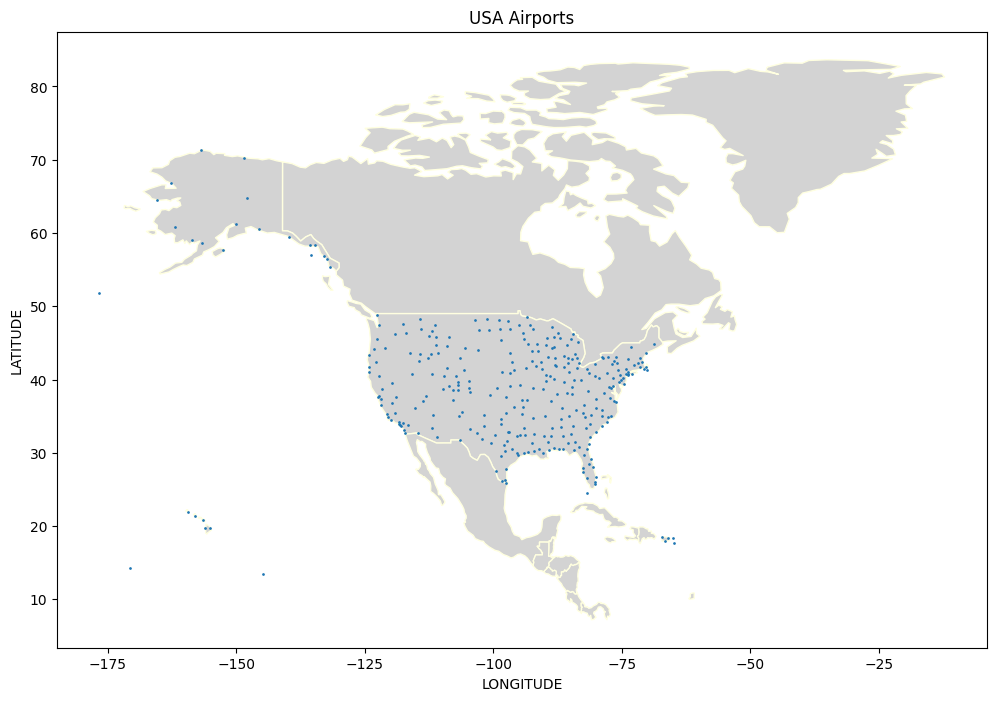

In [ ]:
USA = countries[countries['continent'] == 'North America']

# initialize an axis
fig, ax = plt.subplots(figsize=(12,12))

USA.plot(color="lightgray", edgecolor='lightyellow', ax=ax)

# plot points
df_airports_d.plot(x="LONGITUDE", y="LATITUDE", kind="scatter", s=0.9,
        title=f"USA Airports", ax=ax)

plt.show();

In [ ]:
train_features_filtered = train_features[
    (train_features['ORIGIN_AIRPORT'].isin(df_airports_d['IATA_CODE'])) &
    (train_features['DESTINATION_AIRPORT'].isin(df_airports_d['IATA_CODE']))
]

test_features_filtered = test_features[
    (test_features['ORIGIN_AIRPORT'].isin(df_airports_d['IATA_CODE'])) &
    (test_features['DESTINATION_AIRPORT'].isin(df_airports_d['IATA_CODE']))
]

In [ ]:
print(f'Odsianych z trainu: {len(train_features) - len(train_features_filtered)}\
 (na {len(train_features)})\n i testu: {len(test_features) - len(test_features_filtered)} (na {len(test_features)})')

Odsianych z trainu: 448650 (na 5314008)
 i testu: 33975 (na 400000)


In [ ]:
all_flights = pd.concat([train_features_filtered, test_features_filtered])

In [ ]:
all_flights

,ID,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,...,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,AIR_TIME,DISTANCE,SCHEDULED_ARRIVAL,DIVERTED,CANCELLED,CANCELLATION_REASON
0,5133505,2021,2,14,6,AA,1077,N454AA,BWI,DFW,...,-9.0,10,832,224.0,168.0,1217,1115,0,0,NaN
1,5051259,2021,12,4,5,WN,2510,N656SW,ONT,SMF,...,2.0,7,939,80.0,65.0,390,1050,0,0,NaN
2,5340710,2021,7,7,2,MQ,3204,N696MQ,DFW,LCH,...,-6.0,12,2216,73.0,52.0,295,2323,0,0,NaN
3,5445255,2021,1,4,7,B6,777,N585JB,BOS,LAS,...,10.0,17,2032,363.0,329.0,2381,2308,0,0,NaN
4,2473736,2021,6,16,2,WN,4924,N462WN,LAX,OAK,...,39.0,8,1822,75.0,54.0,337,1850,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
399995,2071015,2021,6,14,7,DL,1661,N310NW,ATL,PHL,...,-1.0,21,1545,135.0,108.0,666,1740,0,0,NaN
399996,3302488,2021,6,21,7,OO,6480,N917SW,FSD,DEN,...,-3.0,19,958,100.0,79.0,483,1022,0,0,NaN
399997,4059481,2021,7,25,6,WN,3267,N8312C,DEN,SNA,...,-4.0,9,2110,140.0,115.0,846,2225,0,0,NaN
399998,4044954,2021,2,9,1,DL,344,N967DL,ATL,PIT,...,7.0,15,1421,100.0,75.0,526,1539,0,0,NaN


In [ ]:
G = nx.DiGraph()

for _, route in tqdm(all_flights.iterrows()):
    source_airport = route["DESTINATION_AIRPORT"]
    dest_airport = route["ORIGIN_AIRPORT"]

    if len(source_airport) and len(dest_airport):
        # Dodawanie krawędzi z atrybutem 'connection_count'
        if G.has_edge(source_airport, dest_airport):
            G.edges[source_airport, dest_airport]['connection_count'] += 1
        else:
            G.add_edge(source_airport, dest_airport, connection_count=1)

0it [00:00, ?it/s]

In [ ]:
print(f'Ilość krawędzi: {G.number_of_edges()}')

Ilość krawędzi: 4651


In [ ]:
total_connection_count = sum(data['connection_count'] for _, _, data in G.edges(data=True) if 'connection_count' in data)
print(f"Connection count in graph: {total_connection_count}")

Connection count in graph: 5231383


In [ ]:
node_total_connection_counts = {}

for node in G.nodes():
    total_connection_count = sum(data['connection_count'] for _, _, data in G.edges(node, data=True) if 'connection_count' in data)
    node_total_connection_counts[node] = total_connection_count

G_df_connection = pd.DataFrame(list(node_total_connection_counts.items()), columns=['AirPort', 'connection_count'])

In [ ]:
nodes_degree = list(G.degree(G.nodes))
G_df = pd.DataFrame(nodes_degree,columns=['AirPort', 'node_degree'])

In [ ]:
G_df['node_degree'].nunique()

76

In [ ]:
fig = px.histogram(G_df, x='node_degree',
                   width=800, height=500,
                   title='Degrees histogram', nbins=142)
fig.show()

In [ ]:
# najwięcej lotów z udziałem lotniska

sorted_airports = G_df_connection.sort_values(by='connection_count', ascending=False)
sorted_airports_list = list(sorted_airports['AirPort'])
print(sorted_airports_list[:25])
df_airports_d[df_airports_d['IATA_CODE'] == "ATL"]

['ATL', 'ORD', 'DFW', 'DEN', 'LAX', 'PHX', 'SFO', 'IAH', 'LAS', 'MSP', 'SEA', 'MCO', 'DTW', 'BOS', 'CLT', 'EWR', 'SLC', 'LGA', 'JFK', 'BWI', 'MDW', 'FLL', 'DCA', 'SAN', 'MIA']


,IATA_CODE,AIRPORT,CITY,STATE,COUNTRY,LATITUDE,LONGITUDE
20,ATL,Hartsfield-Jackson Atlanta International Airport,Atlanta,GA,USA,33.64044,-84.42694


In [ ]:
sorted_airports[["AirPort", "connection_count"]].head(10)

,AirPort,connection_count
40,ATL,342864
9,ORD,275470
0,DFW,231855
33,DEN,193147
8,LAX,192189
34,PHX,145496
16,SFO,145389
46,IAH,143811
5,LAS,132121
26,MSP,111145


In [ ]:
# najpopularniejsze trasy
sorted_airports = sorted(G.edges(data=True), key=lambda x: x[2].get('connection_count', 0), reverse=True)
sorted_airports[:10]

[('LAX', 'SFO', {'connection_count': 13410}),
 ('SFO', 'LAX', {'connection_count': 13117}),
 ('LAX', 'JFK', {'connection_count': 11936}),
 ('JFK', 'LAX', {'connection_count': 11797}),
 ('LAX', 'LAS', {'connection_count': 9646}),
 ('LAS', 'LAX', {'connection_count': 9554}),
 ('ORD', 'LGA', {'connection_count': 9216}),
 ('LGA', 'ORD', {'connection_count': 9046}),
 ('HNL', 'OGG', {'connection_count': 8287}),
 ('SFO', 'JFK', {'connection_count': 8285})]

In [ ]:
# z ilu róznych miejsc na dane lotnisko
sorted_airports = G_df.sort_values(by='node_degree', ascending=False)
sorted_airports_list = list(sorted_airports['AirPort'])
sorted_airports_list[:25]

['ATL',
 'ORD',
 'DFW',
 'DEN',
 'MSP',
 'IAH',
 'DTW',
 'SLC',
 'EWR',
 'LAX',
 'SFO',
 'PHX',
 'LAS',
 'MCO',
 'SEA',
 'CLT',
 'MDW',
 'LGA',
 'IAD',
 'BWI',
 'JFK',
 'BOS',
 'TPA',
 'FLL',
 'DCA']

In [ ]:
sorted_airports[["AirPort", "node_degree"]].head(10)

,AirPort,node_degree
40,ATL,336
9,ORD,323
0,DFW,297
33,DEN,278
26,MSP,240
46,IAH,238
30,DTW,224
29,SLC,179
56,EWR,173
8,LAX,161


In [ ]:
top_airports_names = df_airports_d[df_airports_d['IATA_CODE'].isin(sorted_airports_list[:20])]

In [ ]:
top_airports_names

,IATA_CODE,AIRPORT,CITY,STATE,COUNTRY,LATITUDE,LONGITUDE
20,ATL,Hartsfield-Jackson Atlanta International Airport,Atlanta,GA,USA,33.64044,-84.42694
51,BWI,Baltimore-Washington International Airport,Baltimore,MD,USA,39.17540,-76.66820
66,CLT,Charlotte Douglas International Airport,Charlotte,NC,USA,35.21401,-80.94313
85,DEN,Denver International Airport,Denver,CO,USA,39.85841,-104.66700
86,DFW,Dallas/Fort Worth International Airport,Dallas-Fort Worth,TX,USA,32.89595,-97.03720
93,DTW,Detroit Metropolitan Airport,Detroit,MI,USA,42.21206,-83.34884
106,EWR,Newark Liberty International Airport,Newark,NJ,USA,40.69250,-74.16866
149,IAD,Washington Dulles International Airport,Chantilly,VA,USA,38.94453,-77.45581
151,IAH,George Bush Intercontinental Airport,Houston,TX,USA,29.98047,-95.33972
174,LAS,McCarran International Airport,Las Vegas,NV,USA,36.08036,-115.15233


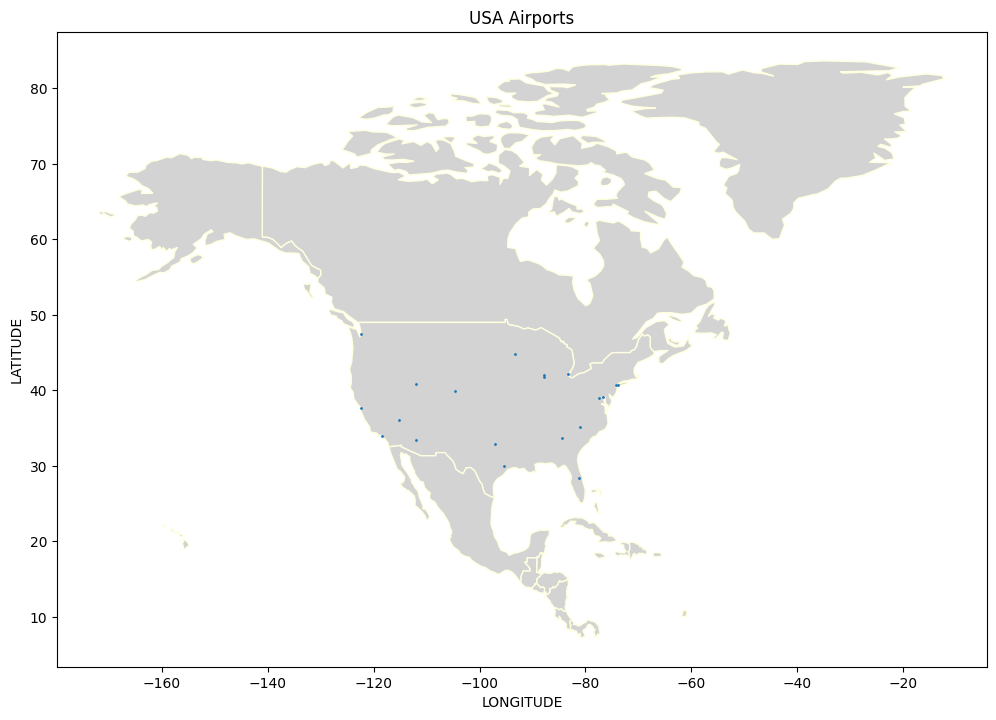

In [ ]:
USA = countries[countries['continent'] == 'North America']

# initialize an axis
fig, ax = plt.subplots(figsize=(12,12))

USA.plot(color="lightgray", edgecolor='lightyellow', ax=ax)

# plot points
top_airports_names.plot(x="LONGITUDE", y="LATITUDE", kind="scatter", s=1,
        title=f"USA Airports", ax=ax)

plt.show();

In [ ]:
train_set = pd.merge(train_features, train_targets, on='ID')

In [ ]:
def sort_airports(df, by='ORIGIN_AIRPORT'):
    df_late = df[df.ARRIVAL_DELAY > 0].groupby(by=by).agg({"ID": 'count'}).rename(columns={"ID": "COUNT"})
    df_ontime = df[df.ARRIVAL_DELAY <= 0].groupby(by=by).agg({"ID": 'count'}).rename(columns={"ID": "COUNT"})
    df_late_perc = (df_late *100 / (df_late + df_ontime)).rename(columns={'COUNT': "DELAYED_PERCENTAGE"})
    df_late_perc = df_late_perc.sort_values(by="DELAYED_PERCENTAGE", ascending=False)

    return df_late_perc.fillna(0)

In [ ]:
delayed_origin_airports = sort_airports(train_set, 'ORIGIN_AIRPORT')
delayed_destination_airports = sort_airports(train_set, 'DESTINATION_AIRPORT')

In [ ]:
delayed_origin_airports

,DELAYED_PERCENTAGE
ORIGIN_AIRPORT,
14222,88.888889
ADK,65.432099
GST,64.179104
PPG,63.725490
ILG,58.333333
...,...
10779,10.169492
11067,9.523810
15041,7.142857


In [ ]:
delayed_destination_airports

,DELAYED_PERCENTAGE
DESTINATION_AIRPORT,
14025,76.923077
13964,70.370370
10918,63.461538
11577,61.111111
15070,61.016949
...,...
11067,10.309278
VEL,9.239130
12016,6.896552


In [ ]:
delayed_destination_airports.loc['14222']

DELAYED_PERCENTAGE    50.0
Name: 14222, dtype: float64

In [ ]:
delayed_origin_airports.loc['14222']

DELAYED_PERCENTAGE    88.888889
Name: 14222, dtype: float64

In [ ]:
for node in G.nodes():
    if node in delayed_destination_airports.index:
        delayed_percentage = delayed_destination_airports.loc[node, 'DELAYED_PERCENTAGE']
        G.nodes[node]['DELAYED_DESTINATION'] = delayed_percentage

    if node in delayed_origin_airports.index:
        delayed_percentage = delayed_origin_airports.loc[node, 'DELAYED_PERCENTAGE']
        G.nodes[node]['DELAYED_ORIGIN'] = delayed_percentage

In [ ]:
for node in G.nodes(data=True):
    print(f"Atrybuty wierzchołka {node[0]}: {node[1]}")
    break

Atrybuty wierzchołka DFW: {'DELAYED_DESTINATION': 35.92353203011981, 'DELAYED_ORIGIN': 40.01996469207236}


In [ ]:
import pickle

with open('graph_delays.gpickle', 'wb') as f:
    pickle.dump(G, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
with open('graph_delays.gpickle', 'rb') as f:
    loaded_graph = pickle.load(f)

##Train set

In [ ]:
print(train_targets['ARRIVAL_DELAY'].min(), train_targets['ARRIVAL_DELAY'].max())

-87.0 1971.0


In [ ]:
train_targets.head(5)

,ID,ARRIVAL_DELAY
0,5133505,-35.0
1,5051259,-2.0
2,5340710,-10.0
3,5445255,-1.0
4,2473736,31.0


In [ ]:
train_targets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5314008 entries, 0 to 5314007
Data columns (total 2 columns):
 #   Column         Dtype  
---  ------         -----  
 0   ID             int64  
 1   ARRIVAL_DELAY  float64
dtypes: float64(1), int64(1)
memory usage: 81.1 MB


In [ ]:
train_features.head(5)

,ID,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,...,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,AIR_TIME,DISTANCE,SCHEDULED_ARRIVAL,DIVERTED,CANCELLED,CANCELLATION_REASON
0,5133505,2021,2,14,6,AA,1077,N454AA,BWI,DFW,...,-9.0,10,832,224.0,168.0,1217,1115,0,0,NaN
1,5051259,2021,12,4,5,WN,2510,N656SW,ONT,SMF,...,2.0,7,939,80.0,65.0,390,1050,0,0,NaN
2,5340710,2021,7,7,2,MQ,3204,N696MQ,DFW,LCH,...,-6.0,12,2216,73.0,52.0,295,2323,0,0,NaN
3,5445255,2021,1,4,7,B6,777,N585JB,BOS,LAS,...,10.0,17,2032,363.0,329.0,2381,2308,0,0,NaN
4,2473736,2021,6,16,2,WN,4924,N462WN,LAX,OAK,...,39.0,8,1822,75.0,54.0,337,1850,0,0,NaN


In [ ]:
train_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5314008 entries, 0 to 5314007
Data columns (total 22 columns):
 #   Column               Dtype  
---  ------               -----  
 0   ID                   int64  
 1   YEAR                 int64  
 2   MONTH                int64  
 3   DAY                  int64  
 4   DAY_OF_WEEK          int64  
 5   AIRLINE              object 
 6   FLIGHT_NUMBER        int64  
 7   TAIL_NUMBER          object 
 8   ORIGIN_AIRPORT       object 
 9   DESTINATION_AIRPORT  object 
 10  SCHEDULED_DEPARTURE  int64  
 11  DEPARTURE_TIME       int64  
 12  DEPARTURE_DELAY      float64
 13  TAXI_OUT             int64  
 14  WHEELS_OFF           int64  
 15  SCHEDULED_TIME       float64
 16  AIR_TIME             float64
 17  DISTANCE             int64  
 18  SCHEDULED_ARRIVAL    int64  
 19  DIVERTED             int64  
 20  CANCELLED            int64  
 21  CANCELLATION_REASON  float64
dtypes: float64(4), int64(14), object(4)
memory usage: 891.9+ MB


###EDA

In [ ]:
train_set = pd.merge(train_features, train_targets, on='ID')

In [ ]:
train_set.head()

,ID,YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,...,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,AIR_TIME,DISTANCE,SCHEDULED_ARRIVAL,DIVERTED,CANCELLED,CANCELLATION_REASON,ARRIVAL_DELAY
0,5133505,2021,2,14,6,AA,1077,N454AA,BWI,DFW,...,10,832,224.0,168.0,1217,1115,0,0,NaN,-35.0
1,5051259,2021,12,4,5,WN,2510,N656SW,ONT,SMF,...,7,939,80.0,65.0,390,1050,0,0,NaN,-2.0
2,5340710,2021,7,7,2,MQ,3204,N696MQ,DFW,LCH,...,12,2216,73.0,52.0,295,2323,0,0,NaN,-10.0
3,5445255,2021,1,4,7,B6,777,N585JB,BOS,LAS,...,17,2032,363.0,329.0,2381,2308,0,0,NaN,-1.0
4,2473736,2021,6,16,2,WN,4924,N462WN,LAX,OAK,...,8,1822,75.0,54.0,337,1850,0,0,NaN,31.0


In [ ]:
profile = ProfileReport(train_set,title="train_features Profiling Report")

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file("airline_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Ważne cechy:
- SCHEDULED_DEPARTURE
- DEPARTURE_TIME
-	DEPARTURE_DELAY
-	TAXI_OUT
-	WHEELS_OFF
- SCHEDULED_ARRIVAL
- ORIGIN_AIRPORT
- DESTINATION_AIRPORT

In [ ]:
best_columns = ["ID", "SCHEDULED_DEPARTURE", "DEPARTURE_TIME", "DEPARTURE_DELAY",
                "TAXI_OUT", "WHEELS_OFF", "SCHEDULED_ARRIVAL", "ORIGIN_AIRPORT",
                "DESTINATION_AIRPORT"]

X_train_selected = train_features[best_columns]
X_test_selected = test_features[best_columns]

X_train_selected.head()

,ID,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_ARRIVAL
0,5133505,831,822,-9.0,10,832,1115
1,5051259,930,932,2.0,7,939,1050
2,5340710,2210,2204,-6.0,12,2216,2323
3,5445255,2005,2015,10.0,17,2032,2308
4,2473736,1735,1814,39.0,8,1822,1850


## Airports representation

In [ ]:
import pickle
import networkx as nx

with open('/content/gdrive/MyDrive/graph_delays-1.gpickle', 'rb') as f:
    airports_graph = pickle.load(f)

In [ ]:
print(len(airports_graph.nodes()))
print(len(airports_graph.edges()))

322
4651


In [ ]:
df_airports = pd.read_csv('/content/gdrive/MyDrive/GeoSpatial/data/airports.csv')
df_airports

,Airport ID,Name,City,Country,IATA,ICAO,Latitude,Longitude,Altitude,Timezone,DST,Tz database time zone,Type,Source
0,1,Goroka Airport,Goroka,Papua New Guinea,GKA,AYGA,-6.081690,145.391998,5282,10,U,Pacific/Port_Moresby,airport,OurAirports
1,2,Madang Airport,Madang,Papua New Guinea,MAG,AYMD,-5.207080,145.789001,20,10,U,Pacific/Port_Moresby,airport,OurAirports
2,3,Mount Hagen Kagamuga Airport,Mount Hagen,Papua New Guinea,HGU,AYMH,-5.826790,144.296005,5388,10,U,Pacific/Port_Moresby,airport,OurAirports
3,4,Nadzab Airport,Nadzab,Papua New Guinea,LAE,AYNZ,-6.569803,146.725977,239,10,U,Pacific/Port_Moresby,airport,OurAirports
4,5,Port Moresby Jacksons International Airport,Port Moresby,Papua New Guinea,POM,AYPY,-9.443380,147.220001,146,10,U,Pacific/Port_Moresby,airport,OurAirports
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7693,14106,Rogachyovo Air Base,Belaya,Russia,\N,ULDA,71.616699,52.478298,272,\N,\N,\N,airport,OurAirports
7694,14107,Ulan-Ude East Airport,Ulan Ude,Russia,\N,XIUW,51.849998,107.737999,1670,\N,\N,\N,airport,OurAirports
7695,14108,Krechevitsy Air Base,Novgorod,Russia,\N,ULLK,58.625000,31.385000,85,\N,\N,\N,airport,OurAirports
7696,14109,Desierto de Atacama Airport,Copiapo,Chile,CPO,SCAT,-27.261200,-70.779198,670,\N,\N,\N,airport,OurAirports


In [ ]:
for node, data in airports_graph.nodes(data=True):
    row = df_airports[df_airports["IATA"] == node]

    if not row.empty:
        data['LATITUDE'] = row["Latitude"].values[0]
        data['LONGITUDE'] = row["Longitude"].values[0]
        data['ALTITUDE'] = row["Altitude"].values[0]

In [ ]:
import torch
import numpy as np

node_features = []
delays = []

for node, data in airports_graph.nodes(data=True):
    node_features.append([data['LATITUDE'], data['LONGITUDE'], data['ALTITUDE']])
    delays.append([data['DELAYED_DESTINATION'], data['DELAYED_ORIGIN']])

x = np.array(node_features)
min_vals = x.min(axis=0)
max_vals = x.max(axis=0)
normalized_tensor = (x - min_vals) / (max_vals - min_vals)
x = torch.tensor(normalized_tensor, dtype=torch.float)

delays = torch.tensor(delays, dtype=torch.float)
min_value = delays.min()
max_value = delays.max()
delays = (delays - min_value) / (max_value - min_value)

In [ ]:
adj_matrix = nx.to_scipy_sparse_array(airports_graph)
edges = adj_matrix.nonzero()
edge_index = torch.tensor(edges, dtype=torch.long)

In [ ]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 7.8 MB/s eta 0:00:00


In [ ]:
from torch_geometric.nn.models import GAE, InnerProductDecoder
from torch_geometric.nn import SAGEConv
from torch import nn

class SageModel(torch.nn.Module):
    def __init__(self, inn, hidden, out):
        super().__init__()
        self.conv1 = SAGEConv(inn, hidden)
        self.bn1 = nn.BatchNorm1d(hidden)
        self.act1 = nn.ReLU()
        self.conv2 = SAGEConv(hidden, out)
        self.bn2 = nn.BatchNorm1d(out)
        self.act2 = nn.ReLU()

    def forward(self, x, edge_index):
        z = self.act1(self.bn1(self.conv1(x, edge_index)))
        z = self.act2(self.bn2(self.conv2(z, edge_index)))

        return z

class AirportGNN(torch.nn.Module):
      def __init__(self, inn, hidden, out):
          super().__init__()

          encoder = SageModel(inn, hidden, out)
          decoder = InnerProductDecoder()

          self.gae = GAE(encoder, decoder)

      def forward(
          self,
          x: torch.Tensor,
          edge_index: torch.Tensor
      ) -> torch.Tensor:
          z = self.gae.forward(x, edge_index)
          return z

      def loss(
          self,
          z: torch.Tensor,
          edge_index: torch.Tensor):

          loss = self.gae.recon_loss(z, edge_index)
          return loss

In [ ]:
model = AirportGNN(3, 32, 8)

optimizer = torch.optim.Adam(
            params=model.parameters(),
            lr=1e-3)

def train(model, data, edge_index, epochs=10):
  for epoch in range(epochs):
    optimizer.zero_grad()
    z = model(data, edge_index)
    loss = model.loss(z, edge_index)
    loss.backward()
    optimizer.step()


train(model, x, edge_index)

In [ ]:
z = model(x, edge_index)
z = torch.cat((z, delays), dim=1)

print(z[0])
print(z[100])
print(z[300])

z = z.detach().numpy()

tensor([0.2822, 0.0357, 0.0000, 0.6155, 0.0000, 0.4714, 0.6779, 0.0000, 0.5218,
        0.5882], grad_fn=<SelectBackward0>)
tensor([0.3366, 0.2567, 0.0000, 0.6398, 0.0000, 0.3705, 0.6993, 0.0000, 0.6675,
        0.5735], grad_fn=<SelectBackward0>)
tensor([0.0000, 0.0000, 0.7120, 0.0000, 2.3436, 0.0000, 0.0000, 1.5323, 0.8534,
        0.3967], grad_fn=<SelectBackward0>)


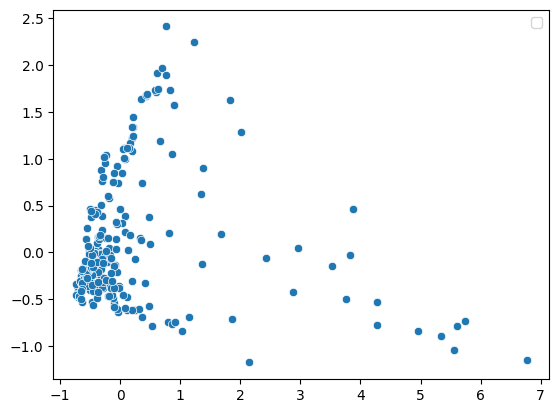

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

def visualize_embeddings(z: torch.Tensor):
    z2d_pca = PCA(n_components=2).fit_transform(z)
    sns.scatterplot(
        x=z2d_pca[:, 0],
        y=z2d_pca[:, 1],
    )

    plt.legend([])
    plt.show()

    return z2d_pca

z2d_pca = visualize_embeddings(z)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


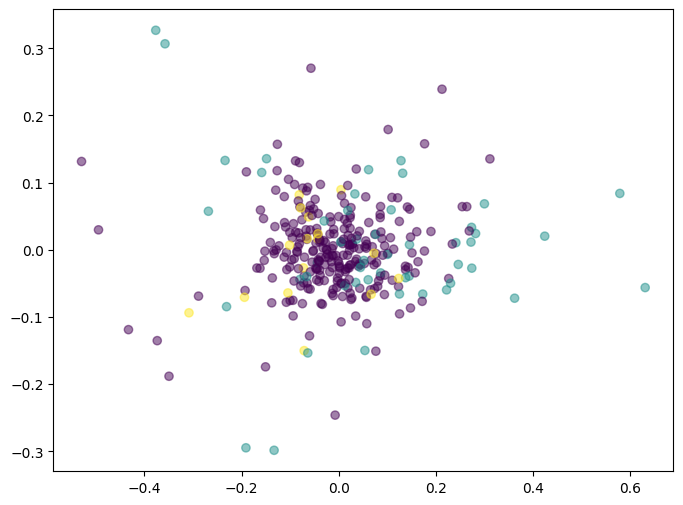

<ipython-input-129-c01060a09784>:26: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


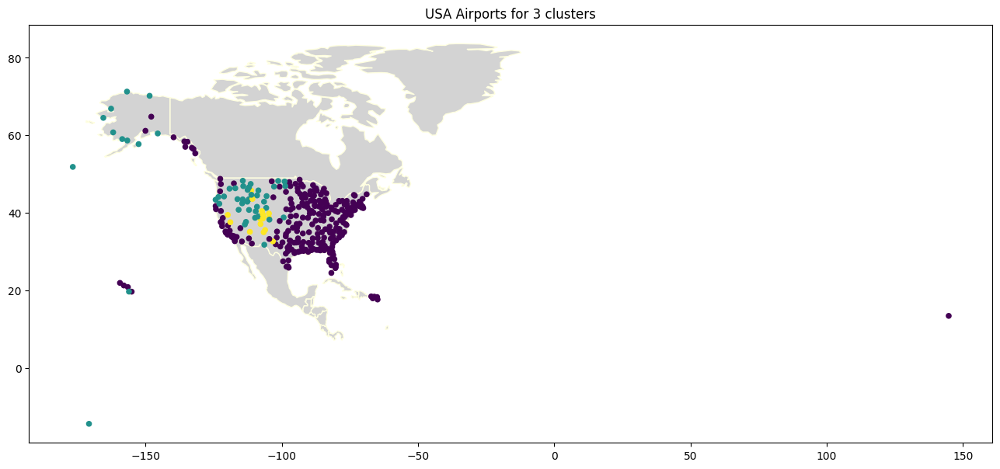

In [ ]:
from sklearn.cluster import KMeans

def cluster_embeddings(z, z2d_pca, n_clusters=5):

  kmeans = KMeans(n_clusters=n_clusters, random_state=42)
  kmeans.fit(z)

  cluster_labels = kmeans.labels_

  plt.figure(figsize=(8, 6))
  plt.scatter(z2d_pca[:, 0], z2d_pca[:, 1], c=cluster_labels, alpha=0.5)
  plt.show()

  clustering = {}
  clustering["Latitude"] = []
  clustering["Longitude"] = []
  clustering["Cluster"] = []

  for i, (node, data) in enumerate(airports_graph.nodes(data=True)):
    clustering["Latitude"].append(data["LATITUDE"])
    clustering["Longitude"].append(data["LONGITUDE"])
    clustering["Cluster"].append(cluster_labels[i])


  clustering_df = pd.DataFrame(clustering)
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
  USA = countries[countries['continent'] == 'North America']

  fig, ax = plt.subplots(figsize=(16,16))

  USA.plot(color="lightgray", edgecolor='lightyellow', ax=ax)
  scatter = ax.scatter(clustering_df["Longitude"], clustering_df["Latitude"], c=clustering_df["Cluster"], cmap="viridis", s=20)
  ax.set_title(f"USA Airports for {n_clusters} clusters")

  plt.colorbar(scatter, ax=ax).remove()
  plt.show()


cluster_embeddings(z, z2d_pca, 3)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


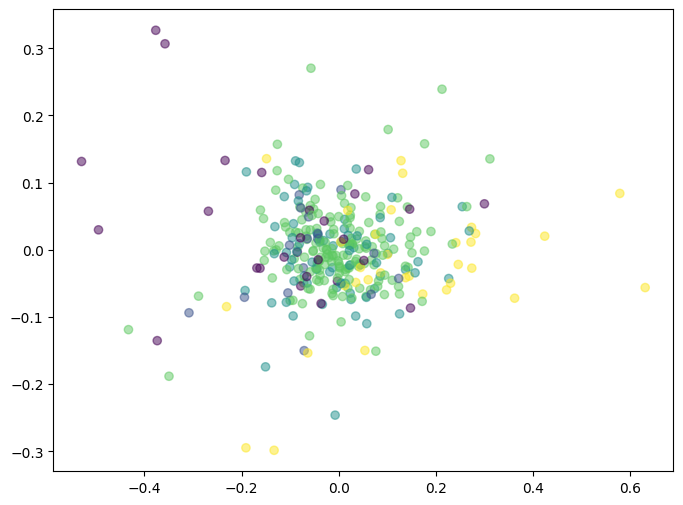

<ipython-input-129-c01060a09784>:26: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


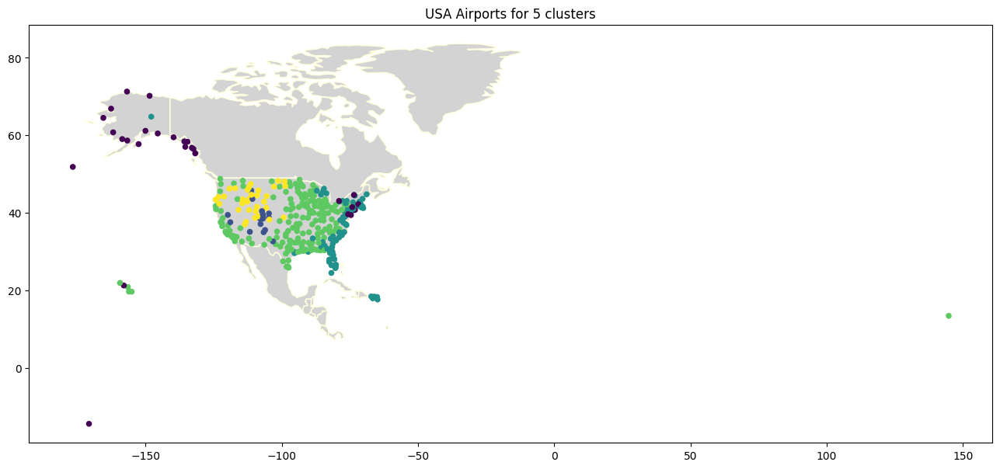

In [ ]:
cluster_embeddings(z, z2d_pca, 5)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


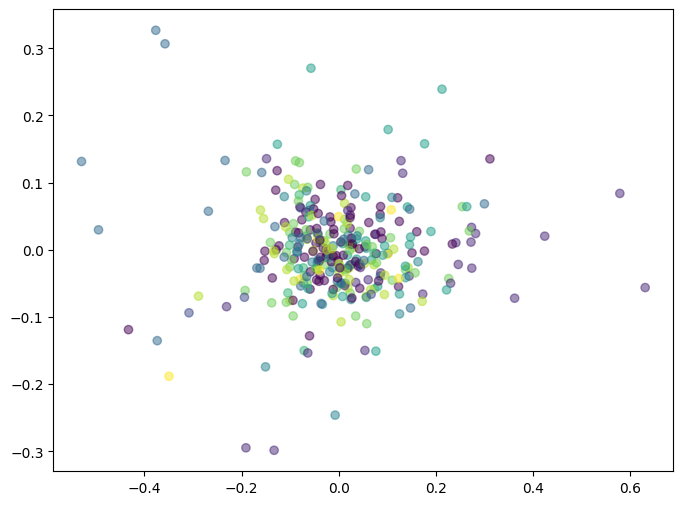

<ipython-input-129-c01060a09784>:26: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


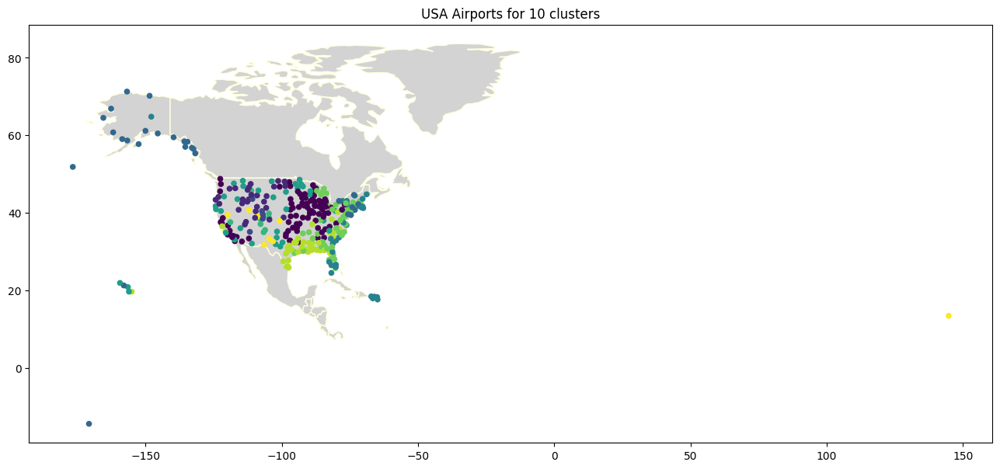

In [ ]:
cluster_embeddings(z, z2d_pca, 10)

In [ ]:
representation = {}
representation["Airport"] = []
representation["Representation"] = []

for i, node in enumerate(airports_graph.nodes()):
  representation["Airport"].append(node)
  representation["Representation"].append(z[i])

representation_df = pd.DataFrame(representation)
representation_df.to_csv("airport_representation.csv", index=False)
representation_df

,Airport,Representation
0,DFW,"[0.2822029, 0.0356931, 0.0, 0.615528, 0.0, 0.4..."
1,BWI,"[0.514231, 0.47058448, 0.0, 0.73797894, 0.0, 0..."
2,SMF,"[0.0, 0.5886985, 0.0, 0.18397535, 0.0, 0.41361..."
3,ONT,"[0.0, 0.14536707, 0.0, 0.3538847, 0.24288586, ..."
4,LCH,"[0.0, 0.40515003, 0.0, 0.0, 0.0, 0.6386466, 0...."
...,...,...
317,ILG,"[0.71501094, 1.244668, 0.0, 0.0, 0.0, 0.429754..."
318,AKN,"[1.1414891, 1.1568592, 0.0, 0.0, 1.2805897, 0...."
319,GST,"[1.2410477, 1.8153359, 0.0, 0.0, 0.29224706, 0..."
320,CNY,"[0.0, 0.0, 0.0, 0.0, 2.003613, 0.0, 0.0, 0.0, ..."


In [ ]:
import numpy as np
from sklearn.metrics.pairwise import euclidean_distances

representations = np.stack(representation_df['Representation'].values)

distances = euclidean_distances(representations)
np.fill_diagonal(distances, np.inf)
min_indices = np.unravel_index(np.argmin(distances, axis=None), distances.shape)
closest_pair_ids = representation_df.iloc[min_indices[0]]['Airport'], representation_df.iloc[min_indices[1]]['Airport']

x, y = closest_pair_ids
print(closest_pair_ids)

('SJT', 'ABI')


In [ ]:
print(airports_graph.nodes[x])
print(airports_graph.edges(x))
print(airports_graph.nodes[y])
print(airports_graph.edges(y))

{'DELAYED_DESTINATION': 34.80968858131488, 'DELAYED_ORIGIN': 32.20456116102281, 'LATITUDE': 31.35770034790039, 'LONGITUDE': -100.49600219726562, 'ALTITUDE': 1919}
[('SJT', 'DFW')]
{'DELAYED_DESTINATION': 33.05944900918318, 'DELAYED_ORIGIN': 30.63583815028902, 'LATITUDE': 32.4113006592, 'LONGITUDE': -99.6819000244, 'ALTITUDE': 1791}
[('ABI', 'DFW')]


In [ ]:
np.fill_diagonal(distances, 0)
max_indices = np.unravel_index(np.argmax(distances, axis=None), distances.shape)
farest_pair_ids = representation_df.iloc[max_indices[0]]['Airport'], representation_df.iloc[max_indices[1]]['Airport']

x_, y_ = farest_pair_ids
print(farest_pair_ids)

('ASE', 'BRW')


In [ ]:
print(airports_graph.nodes[x_])
print(airports_graph.edges(y_))
print(airports_graph.nodes[x_])
print(airports_graph.edges(y_))

{'DELAYED_DESTINATION': 54.455117588605496, 'DELAYED_ORIGIN': 44.71865745310958, 'LATITUDE': 39.22320175, 'LONGITUDE': -106.8690033, 'ALTITUDE': 7820}
[('BRW', 'SCC'), ('BRW', 'ANC')]
{'DELAYED_DESTINATION': 54.455117588605496, 'DELAYED_ORIGIN': 44.71865745310958, 'LATITUDE': 39.22320175, 'LONGITUDE': -106.8690033, 'ALTITUDE': 7820}
[('BRW', 'SCC'), ('BRW', 'ANC')]


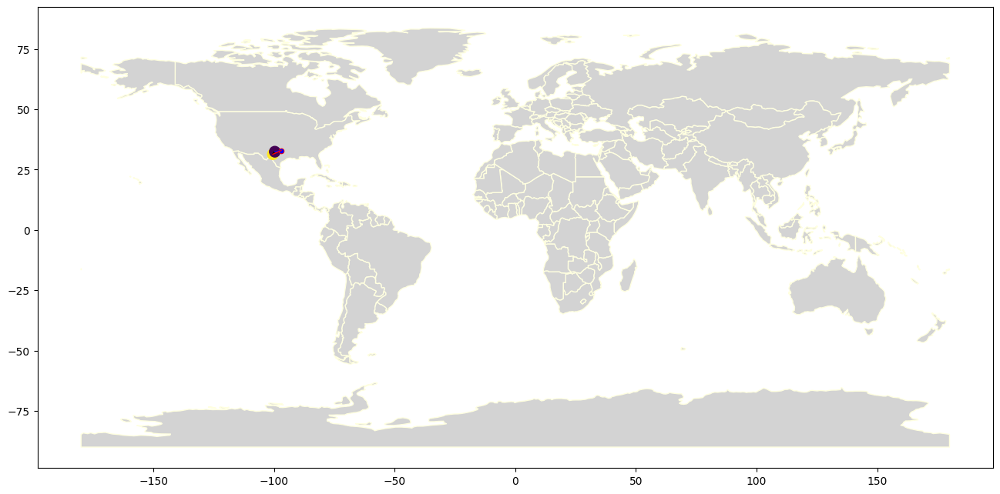

In [ ]:
def show_distance(x, y, width=1):
  df = pd.DataFrame([airports_graph.nodes[x], airports_graph.nodes[y]])
  destinations_x = pd.DataFrame([airports_graph.nodes[destination[1]] for destination in airports_graph.edges(x)])
  destinations_y = pd.DataFrame([airports_graph.nodes[destination[1]] for destination in airports_graph.edges(y)])

  fig, ax = plt.subplots(figsize=(16, 16))

  countries.plot(color="lightgray", edgecolor='lightyellow', ax=ax)
  ax.scatter(df["LONGITUDE"], df["LATITUDE"], c=df["ALTITUDE"], cmap="viridis", s=100)
  ax.scatter(destinations_x["LONGITUDE"], destinations_x["LATITUDE"], color="red", s=20)
  ax.scatter(destinations_y["LONGITUDE"], destinations_y["LATITUDE"], color="blue", s=10)
  ax.plot(df["LONGITUDE"], df["LATITUDE"], 'k--')

  for idx, row in destinations_y.iterrows():
      ax.plot([df.iloc[1]["LONGITUDE"], row["LONGITUDE"]], [df.iloc[1]["LATITUDE"], row["LATITUDE"]], 'b-', linewidth=width)

  for idx, row in destinations_x.iterrows():
      ax.plot([df.iloc[0]["LONGITUDE"], row["LONGITUDE"]], [df.iloc[0]["LATITUDE"], row["LATITUDE"]], 'r-', linewidth=width)

  plt.show()

show_distance(x, y)

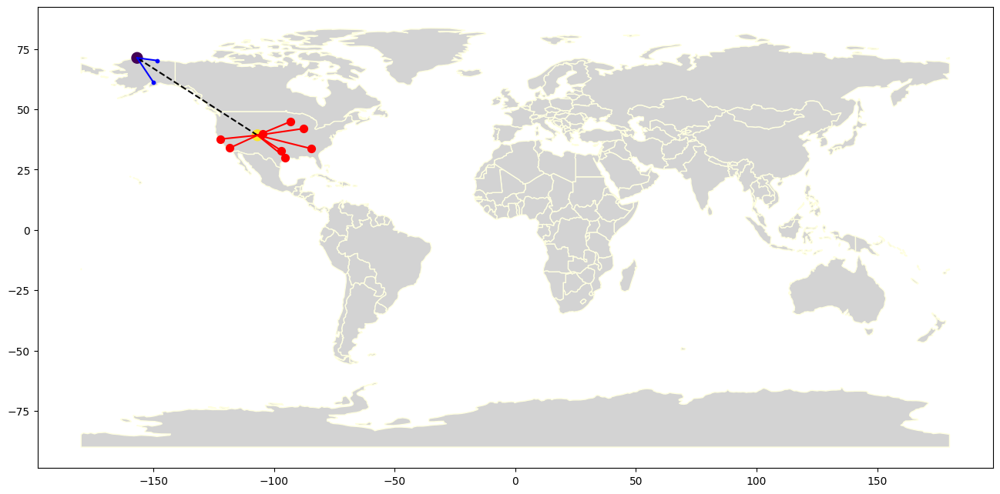

In [ ]:
show_distance(x_, y_)

In [ ]:
representations = np.stack(representation_df['Representation'][-2:].values)

distances = euclidean_distances(representations)
np.fill_diagonal(distances, np.inf)
min_indices = np.unravel_index(np.argmin(distances, axis=None), distances.shape)
closest_pair_ids = representation_df.iloc[min_indices[0]]['Airport'], representation_df.iloc[min_indices[1]]['Airport']

a, b = closest_pair_ids
print(closest_pair_ids)

('DFW', 'BWI')


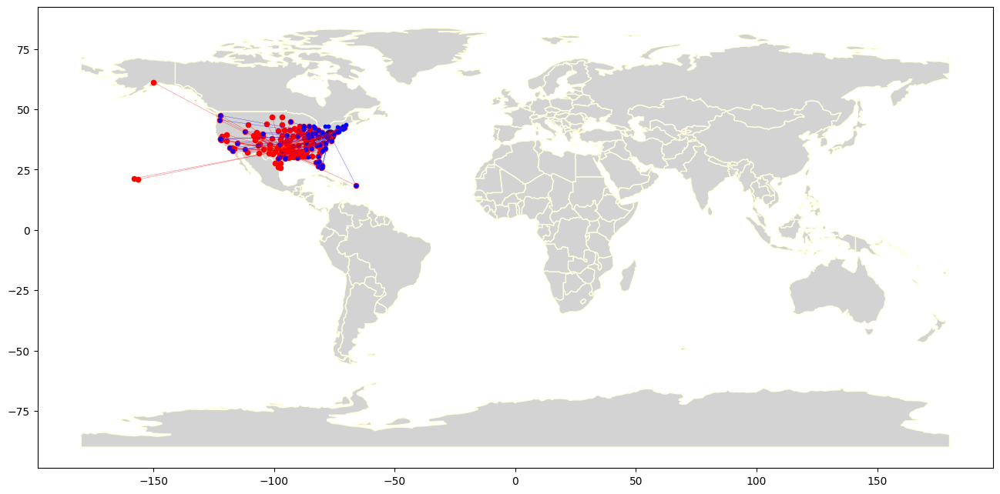

In [ ]:
show_distance(a, b, 0.2)